In [1]:
pip install scikit-learn

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 25.1.1 -> 25.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [2]:
pip install seaborn

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 25.1.1 -> 25.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [3]:
import tensorflow as tf
import numpy as np
import pandas as pd 
from matplotlib import pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import LabelEncoder
import seaborn.objects as so

In [4]:
rainfall_data = pd.read_csv('rainfall in india 1901-2015.csv')
rainfall_data

,SUBDIVISION,YEAR,JAN,FEB,MAR,APR,MAY,JUN,JUL,AUG,SEP,OCT,NOV,DEC,ANNUAL,Jan-Feb,Mar-May,Jun-Sep,Oct-Dec
0,ANDAMAN & NICOBAR ISLANDS,1901,49.2,87.1,29.2,2.3,528.8,517.5,365.1,481.1,332.6,388.5,558.2,33.6,3373.2,136.3,560.3,1696.3,980.3
1,ANDAMAN & NICOBAR ISLANDS,1902,0.0,159.8,12.2,0.0,446.1,537.1,228.9,753.7,666.2,197.2,359.0,160.5,3520.7,159.8,458.3,2185.9,716.7
2,ANDAMAN & NICOBAR ISLANDS,1903,12.7,144.0,0.0,1.0,235.1,479.9,728.4,326.7,339.0,181.2,284.4,225.0,2957.4,156.7,236.1,1874.0,690.6
3,ANDAMAN & NICOBAR ISLANDS,1904,9.4,14.7,0.0,202.4,304.5,495.1,502.0,160.1,820.4,222.2,308.7,40.1,3079.6,24.1,506.9,1977.6,571.0
4,ANDAMAN & NICOBAR ISLANDS,1905,1.3,0.0,3.3,26.9,279.5,628.7,368.7,330.5,297.0,260.7,25.4,344.7,2566.7,1.3,309.7,1624.9,630.8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4111,LAKSHADWEEP,2011,5.1,2.8,3.1,85.9,107.2,153.6,350.2,254.0,255.2,117.4,184.3,14.9,1533.7,7.9,196.2,1013.0,316.6
4112,LAKSHADWEEP,2012,19.2,0.1,1.6,76.8,21.2,327.0,231.5,381.2,179.8,145.9,12.4,8.8,1405.5,19.3,99.6,1119.5,167.1
4113,LAKSHADWEEP,2013,26.2,34.4,37.5,5.3,88.3,426.2,296.4,154.4,180.0,72.8,78.1,26.7,1426.3,60.6,131.1,1057.0,177.6
4114,LAKSHADWEEP,2014,53.2,16.1,4.4,14.9,57.4,244.1,116.1,466.1,132.2,169.2,59.0,62.3,1395.0,69.3,76.7,958.5,290.5


In [5]:
rainfall_data['JAN'].fillna(13.3,inplace=True)
rainfall_data['FEB'].fillna(14.5,inplace=True)
rainfall_data['MAR'].fillna(12.4,inplace=True)
rainfall_data['APR'].fillna(16.8,inplace=True)
rainfall_data['MAY'].fillna(14.9,inplace=True)
rainfall_data['JUN'].fillna(67.9,inplace=True)
rainfall_data['JUL'].fillna(77.1,inplace=True)
rainfall_data['JUL'].fillna(90.2,inplace=True)
rainfall_data['AUG'].fillna(22.6,inplace=True)
rainfall_data['SEP'].fillna(89.1,inplace=True)
rainfall_data['OCT'].fillna(34.5,inplace=True)
rainfall_data['NOV'].fillna(11.6,inplace=True)
rainfall_data['DEC'].fillna(6.5,inplace=True)

C:\Users\pc\AppData\Local\Temp\ipykernel_13188\1448869579.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  rainfall_data['JAN'].fillna(13.3,inplace=True)
C:\Users\pc\AppData\Local\Temp\ipykernel_13188\1448869579.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, wh

In [6]:
rainfall_data['ANNUAL'] = rainfall_data['ANNUAL'].fillna( rainfall_data[['JAN','FEB','MAR','APR','MAY','JUN',
                'JUL','AUG','SEP','OCT','NOV','DEC']].sum(axis=1)
)

In [7]:
rainfall_data['Jan-Feb'] = rainfall_data['Jan-Feb'].fillna(rainfall_data[['JAN','FEB']].sum(axis=1))

In [8]:
rainfall_data['Mar-May'] = rainfall_data['Mar-May'].fillna(rainfall_data[['MAR','APR','MAY']].sum(axis=1))

In [9]:
rainfall_data['Jun-Sep'] = rainfall_data['Jun-Sep'].fillna(rainfall_data[['JUN','JUL','AUG','SEP']].sum(axis=1))

In [10]:
rainfall_data['Oct-Dec'] = rainfall_data['Oct-Dec'].fillna(rainfall_data[['OCT','NOV','DEC']].sum(axis=1))

In [11]:
print(rainfall_data.isnull().sum().astype(int))

SUBDIVISION    0
YEAR           0
JAN            0
FEB            0
MAR            0
APR            0
MAY            0
JUN            0
JUL            0
AUG            0
SEP            0
OCT            0
NOV            0
DEC            0
ANNUAL         0
Jan-Feb        0
Mar-May        0
Jun-Sep        0
Oct-Dec        0
dtype: int64


In [12]:
india_rainfall_data = rainfall_data.sort_values(by="YEAR", ascending=True).reset_index(drop=True)
pd.set_option("display.max_rows", None)
pd.set_option("display.max_columns", None)

In [13]:
#SubDivison Count
subdivison_count = india_rainfall_data.groupby('YEAR')['SUBDIVISION'].count().reset_index()

In [14]:
subdivison_count

,YEAR,SUBDIVISION
0,1901,35
1,1902,35
2,1903,35
3,1904,35
4,1905,35
5,1906,35
6,1907,35
7,1908,35
8,1909,34
9,1910,35


In [15]:
#Annual Rain sum by Year 
annualrain_sum = india_rainfall_data.groupby('YEAR')['ANNUAL'].sum().reset_index()
annualrain_sum

,YEAR,ANNUAL
0,1901,44947.5
1,1902,46805.6
2,1903,48994.5
3,1904,43287.0
4,1905,41516.2
5,1906,47180.2
6,1907,45443.9
7,1908,46453.7
8,1909,45677.8
9,1910,50265.1


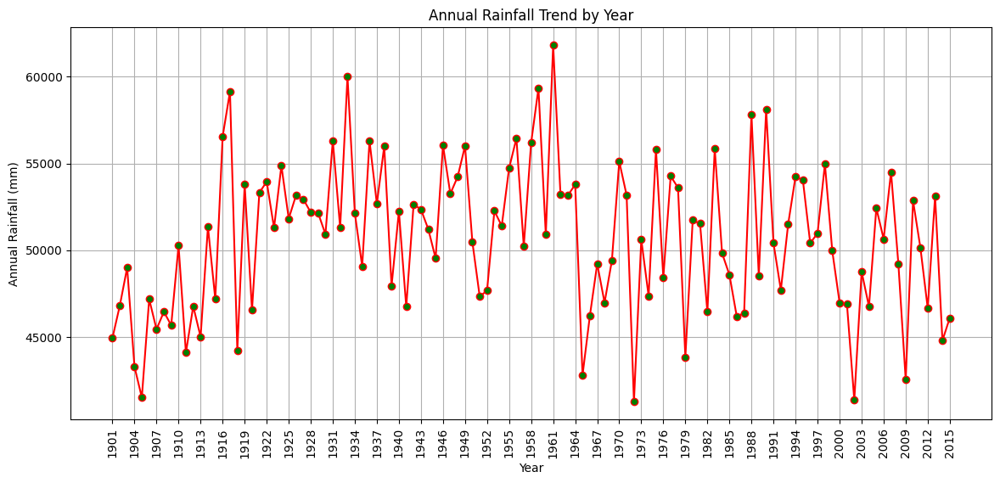

In [16]:
plt.figure(figsize=(14,6))
plt.plot(annualrain_sum['YEAR'], annualrain_sum['ANNUAL'], marker='o',linestyle='-', markerfacecolor="green",color="red")
plt.title("Annual Rainfall Trend by Year")
plt.xlabel("Year")
plt.ylabel("Annual Rainfall (mm)")
plt.grid(True)

plt.xticks(annualrain_sum['YEAR'][::3], rotation=90) 
plt.show()

In [17]:
def check_rainfall(value):
    if value < 1176.9:
        return "Bad Rain"
    else:
        return "Good Rain"

india_rainfall_data['Annual Rainfall Result'] = india_rainfall_data['ANNUAL'].apply(check_rainfall)

In [18]:
subdivison_crosstab = pd.crosstab(india_rainfall_data['SUBDIVISION'],india_rainfall_data['Annual Rainfall Result'])
subdivison_crosstab

Annual Rainfall Result,Bad Rain,Good Rain
SUBDIVISION,,
ANDAMAN & NICOBAR ISLANDS,2,108
ARUNACHAL PRADESH,0,97
ASSAM & MEGHALAYA,0,115
BIHAR,50,65
CHHATTISGARH,17,98
COASTAL ANDHRA PRADESH,89,26
COASTAL KARNATAKA,0,115
EAST MADHYA PRADESH,53,62
EAST RAJASTHAN,114,1


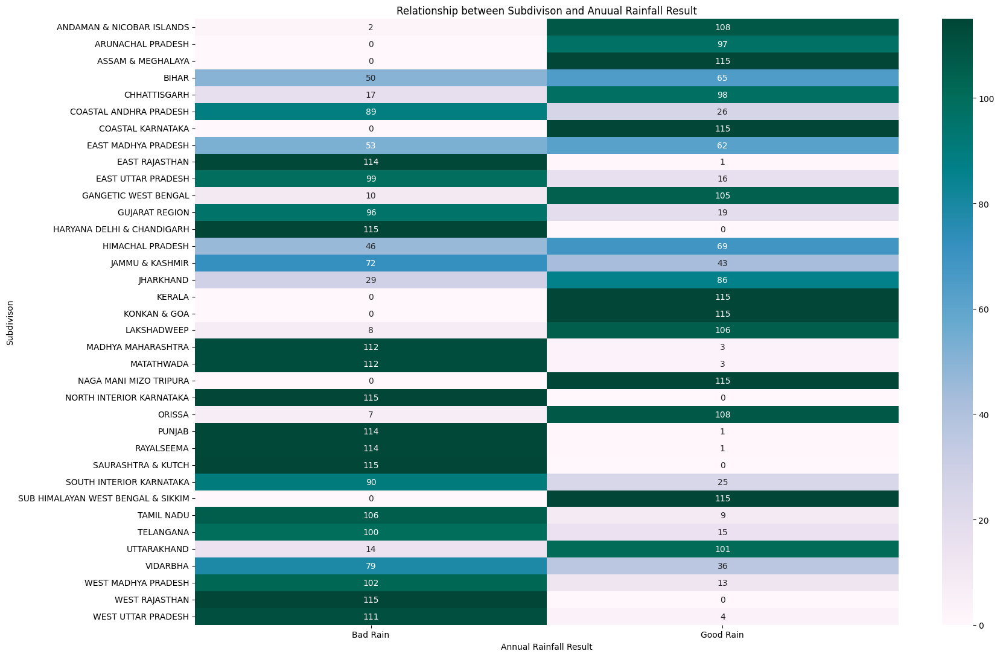

In [19]:
plt.figure(figsize=(18, 11))
sns.heatmap(subdivison_crosstab, annot=True, fmt='d', cmap='PuBuGn')

plt.title('Relationship between Subdivison and Anuual Rainfall Result')
plt.xlabel('Annual Rainfall Result')
plt.ylabel('Subdivison')
plt.tight_layout()
plt.show()

In [20]:
Kerala = india_rainfall_data[india_rainfall_data.SUBDIVISION == 'KERALA']

In [21]:
kerala_rain_sum = Kerala.groupby('YEAR')['ANNUAL'].sum().reset_index()
kerala_rain_sum

,YEAR,ANNUAL
0,1901,3248.6
1,1902,3326.6
2,1903,3271.2
3,1904,3129.7
4,1905,2741.6
5,1906,2708.0
6,1907,3671.1
7,1908,2648.3
8,1909,3050.2
9,1910,2848.6


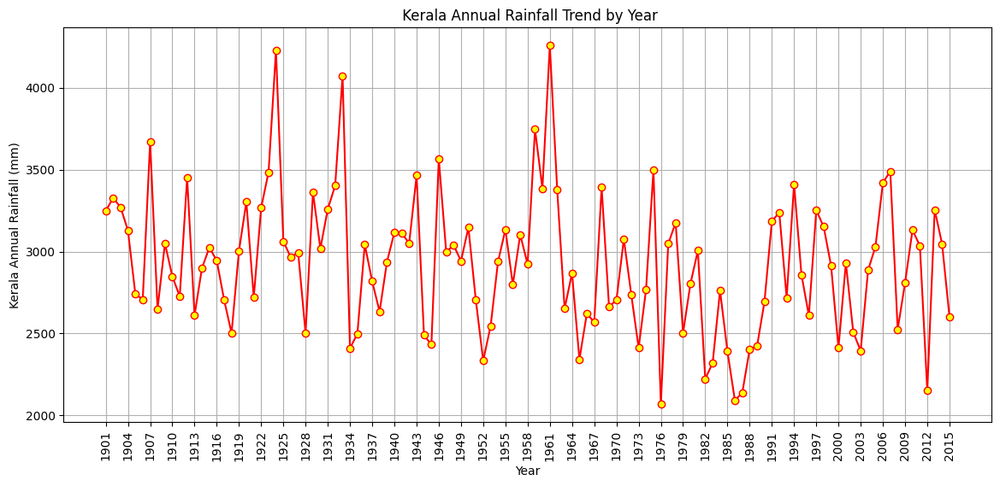

In [22]:
plt.figure(figsize=(14,6))
plt.plot(kerala_rain_sum['YEAR'], kerala_rain_sum['ANNUAL'], marker='o',linestyle='-', markerfacecolor="yellow",color="red")
plt.title(" Kerala Annual Rainfall Trend by Year")
plt.xlabel("Year")
plt.ylabel("Kerala Annual Rainfall (mm)")
plt.grid(True)

plt.xticks(annualrain_sum['YEAR'][::3], rotation=90) 
plt.show()

In [23]:
india_rainfall_data['MONTHLY_AVG'] =  (india_rainfall_data['ANNUAL'] / 12).astype(int)
india_rainfall_data

,SUBDIVISION,YEAR,JAN,FEB,MAR,APR,MAY,JUN,JUL,AUG,SEP,OCT,NOV,DEC,ANNUAL,Jan-Feb,Mar-May,Jun-Sep,Oct-Dec,Annual Rainfall Result,MONTHLY_AVG
0,LAKSHADWEEP,1901,22.6,86.4,114.8,263.8,37.3,459.0,0.0,0.0,46.7,183.7,229.9,15.0,1459.2,109.0,415.9,505.7,428.6,Good Rain,121
1,KERALA,1901,28.7,44.7,51.6,160.0,174.7,824.6,743.0,357.5,197.7,266.9,350.8,48.4,3248.6,73.4,386.2,2122.8,666.1,Good Rain,270
2,GANGETIC WEST BENGAL,1901,37.1,58.4,3.9,64.1,121.7,198.0,280.8,275.7,313.5,51.1,83.4,0.0,1487.6,95.5,189.7,1068.0,134.4,Good Rain,123
3,ORISSA,1901,39.5,65.1,16.1,51.6,79.0,78.2,288.4,307.7,185.3,76.6,96.7,0.0,1284.2,104.6,146.7,859.6,173.3,Good Rain,107
4,EAST UTTAR PRADESH,1901,62.6,31.3,8.2,1.1,13.6,21.8,226.5,285.6,215.4,4.9,0.1,2.1,873.2,93.9,22.9,749.3,7.1,Bad Rain,72
5,JHARKHAND,1901,92.7,66.6,11.1,18.4,33.5,70.9,269.4,415.1,248.0,37.3,11.5,0.0,1274.5,159.3,63.0,1003.4,48.8,Good Rain,106
6,BIHAR,1901,51.8,19.6,11.9,1.1,65.6,66.3,245.9,319.4,155.1,8.3,7.3,0.1,952.3,71.4,78.6,786.7,15.6,Bad Rain,79
7,WEST UTTAR PRADESH,1901,51.4,25.6,9.5,0.7,5.6,23.8,201.9,374.3,67.7,7.6,0.0,7.9,775.9,76.9,15.8,667.7,15.4,Bad Rain,64
8,UTTARAKHAND,1901,134.5,81.4,44.5,5.9,60.8,33.6,381.1,612.3,167.1,16.3,0.0,24.9,1562.5,215.9,111.3,1194.1,41.3,Good Rain,130
9,SUB HIMALAYAN WEST BENGAL & SIKKIM,1901,26.5,14.8,14.1,29.2,195.5,488.4,524.8,501.1,242.7,55.5,17.9,2.6,2113.2,41.3,238.9,1757.0,76.1,Good Rain,176


In [24]:
india_rainfall_data.drop(columns=['MONTHLY_AVG'])

,SUBDIVISION,YEAR,JAN,FEB,MAR,APR,MAY,JUN,JUL,AUG,SEP,OCT,NOV,DEC,ANNUAL,Jan-Feb,Mar-May,Jun-Sep,Oct-Dec,Annual Rainfall Result
0,LAKSHADWEEP,1901,22.6,86.4,114.8,263.8,37.3,459.0,0.0,0.0,46.7,183.7,229.9,15.0,1459.2,109.0,415.9,505.7,428.6,Good Rain
1,KERALA,1901,28.7,44.7,51.6,160.0,174.7,824.6,743.0,357.5,197.7,266.9,350.8,48.4,3248.6,73.4,386.2,2122.8,666.1,Good Rain
2,GANGETIC WEST BENGAL,1901,37.1,58.4,3.9,64.1,121.7,198.0,280.8,275.7,313.5,51.1,83.4,0.0,1487.6,95.5,189.7,1068.0,134.4,Good Rain
3,ORISSA,1901,39.5,65.1,16.1,51.6,79.0,78.2,288.4,307.7,185.3,76.6,96.7,0.0,1284.2,104.6,146.7,859.6,173.3,Good Rain
4,EAST UTTAR PRADESH,1901,62.6,31.3,8.2,1.1,13.6,21.8,226.5,285.6,215.4,4.9,0.1,2.1,873.2,93.9,22.9,749.3,7.1,Bad Rain
5,JHARKHAND,1901,92.7,66.6,11.1,18.4,33.5,70.9,269.4,415.1,248.0,37.3,11.5,0.0,1274.5,159.3,63.0,1003.4,48.8,Good Rain
6,BIHAR,1901,51.8,19.6,11.9,1.1,65.6,66.3,245.9,319.4,155.1,8.3,7.3,0.1,952.3,71.4,78.6,786.7,15.6,Bad Rain
7,WEST UTTAR PRADESH,1901,51.4,25.6,9.5,0.7,5.6,23.8,201.9,374.3,67.7,7.6,0.0,7.9,775.9,76.9,15.8,667.7,15.4,Bad Rain
8,UTTARAKHAND,1901,134.5,81.4,44.5,5.9,60.8,33.6,381.1,612.3,167.1,16.3,0.0,24.9,1562.5,215.9,111.3,1194.1,41.3,Good Rain
9,SUB HIMALAYAN WEST BENGAL & SIKKIM,1901,26.5,14.8,14.1,29.2,195.5,488.4,524.8,501.1,242.7,55.5,17.9,2.6,2113.2,41.3,238.9,1757.0,76.1,Good Rain


In [25]:
india_rainfall_data

,SUBDIVISION,YEAR,JAN,FEB,MAR,APR,MAY,JUN,JUL,AUG,SEP,OCT,NOV,DEC,ANNUAL,Jan-Feb,Mar-May,Jun-Sep,Oct-Dec,Annual Rainfall Result,MONTHLY_AVG
0,LAKSHADWEEP,1901,22.6,86.4,114.8,263.8,37.3,459.0,0.0,0.0,46.7,183.7,229.9,15.0,1459.2,109.0,415.9,505.7,428.6,Good Rain,121
1,KERALA,1901,28.7,44.7,51.6,160.0,174.7,824.6,743.0,357.5,197.7,266.9,350.8,48.4,3248.6,73.4,386.2,2122.8,666.1,Good Rain,270
2,GANGETIC WEST BENGAL,1901,37.1,58.4,3.9,64.1,121.7,198.0,280.8,275.7,313.5,51.1,83.4,0.0,1487.6,95.5,189.7,1068.0,134.4,Good Rain,123
3,ORISSA,1901,39.5,65.1,16.1,51.6,79.0,78.2,288.4,307.7,185.3,76.6,96.7,0.0,1284.2,104.6,146.7,859.6,173.3,Good Rain,107
4,EAST UTTAR PRADESH,1901,62.6,31.3,8.2,1.1,13.6,21.8,226.5,285.6,215.4,4.9,0.1,2.1,873.2,93.9,22.9,749.3,7.1,Bad Rain,72
5,JHARKHAND,1901,92.7,66.6,11.1,18.4,33.5,70.9,269.4,415.1,248.0,37.3,11.5,0.0,1274.5,159.3,63.0,1003.4,48.8,Good Rain,106
6,BIHAR,1901,51.8,19.6,11.9,1.1,65.6,66.3,245.9,319.4,155.1,8.3,7.3,0.1,952.3,71.4,78.6,786.7,15.6,Bad Rain,79
7,WEST UTTAR PRADESH,1901,51.4,25.6,9.5,0.7,5.6,23.8,201.9,374.3,67.7,7.6,0.0,7.9,775.9,76.9,15.8,667.7,15.4,Bad Rain,64
8,UTTARAKHAND,1901,134.5,81.4,44.5,5.9,60.8,33.6,381.1,612.3,167.1,16.3,0.0,24.9,1562.5,215.9,111.3,1194.1,41.3,Good Rain,130
9,SUB HIMALAYAN WEST BENGAL & SIKKIM,1901,26.5,14.8,14.1,29.2,195.5,488.4,524.8,501.1,242.7,55.5,17.9,2.6,2113.2,41.3,238.9,1757.0,76.1,Good Rain,176


In [26]:
india_rainfall_data['Jan-Feb Percentage'] = ((india_rainfall_data['Jan-Feb'] / india_rainfall_data['ANNUAL']) * 100).round(1)
india_rainfall_data['Mar-May Percentage'] = ((india_rainfall_data['Mar-May'] / india_rainfall_data['ANNUAL']) * 100).round(1)
india_rainfall_data['Jun-Sep Percentage'] = ((india_rainfall_data['Jun-Sep'] / india_rainfall_data['ANNUAL']) * 100).round(1)
india_rainfall_data['Oct-Dec Percentage'] = ((india_rainfall_data['Oct-Dec'] / india_rainfall_data['ANNUAL']) * 100).round(1)
india_rainfall_data

,SUBDIVISION,YEAR,JAN,FEB,MAR,APR,MAY,JUN,JUL,AUG,SEP,OCT,NOV,DEC,ANNUAL,Jan-Feb,Mar-May,Jun-Sep,Oct-Dec,Annual Rainfall Result,MONTHLY_AVG,Jan-Feb Percentage,Mar-May Percentage,Jun-Sep Percentage,Oct-Dec Percentage
0,LAKSHADWEEP,1901,22.6,86.4,114.8,263.8,37.3,459.0,0.0,0.0,46.7,183.7,229.9,15.0,1459.2,109.0,415.9,505.7,428.6,Good Rain,121,7.5,28.5,34.7,29.4
1,KERALA,1901,28.7,44.7,51.6,160.0,174.7,824.6,743.0,357.5,197.7,266.9,350.8,48.4,3248.6,73.4,386.2,2122.8,666.1,Good Rain,270,2.3,11.9,65.3,20.5
2,GANGETIC WEST BENGAL,1901,37.1,58.4,3.9,64.1,121.7,198.0,280.8,275.7,313.5,51.1,83.4,0.0,1487.6,95.5,189.7,1068.0,134.4,Good Rain,123,6.4,12.8,71.8,9.0
3,ORISSA,1901,39.5,65.1,16.1,51.6,79.0,78.2,288.4,307.7,185.3,76.6,96.7,0.0,1284.2,104.6,146.7,859.6,173.3,Good Rain,107,8.1,11.4,66.9,13.5
4,EAST UTTAR PRADESH,1901,62.6,31.3,8.2,1.1,13.6,21.8,226.5,285.6,215.4,4.9,0.1,2.1,873.2,93.9,22.9,749.3,7.1,Bad Rain,72,10.8,2.6,85.8,0.8
5,JHARKHAND,1901,92.7,66.6,11.1,18.4,33.5,70.9,269.4,415.1,248.0,37.3,11.5,0.0,1274.5,159.3,63.0,1003.4,48.8,Good Rain,106,12.5,4.9,78.7,3.8
6,BIHAR,1901,51.8,19.6,11.9,1.1,65.6,66.3,245.9,319.4,155.1,8.3,7.3,0.1,952.3,71.4,78.6,786.7,15.6,Bad Rain,79,7.5,8.3,82.6,1.6
7,WEST UTTAR PRADESH,1901,51.4,25.6,9.5,0.7,5.6,23.8,201.9,374.3,67.7,7.6,0.0,7.9,775.9,76.9,15.8,667.7,15.4,Bad Rain,64,9.9,2.0,86.1,2.0
8,UTTARAKHAND,1901,134.5,81.4,44.5,5.9,60.8,33.6,381.1,612.3,167.1,16.3,0.0,24.9,1562.5,215.9,111.3,1194.1,41.3,Good Rain,130,13.8,7.1,76.4,2.6
9,SUB HIMALAYAN WEST BENGAL & SIKKIM,1901,26.5,14.8,14.1,29.2,195.5,488.4,524.8,501.1,242.7,55.5,17.9,2.6,2113.2,41.3,238.9,1757.0,76.1,Good Rain,176,2.0,11.3,83.1,3.6


In [27]:
def junseprainfall_monsoongoodornot(value):
    if value < 40:
        return "Monsoon is not good"
    else:
        return "Monsoon is good"

india_rainfall_data["Monsoon Status Jun-Sep"] = india_rainfall_data['Jun-Sep Percentage'].apply(junseprainfall_monsoongoodornot)

In [28]:
india_rainfall_data

,SUBDIVISION,YEAR,JAN,FEB,MAR,APR,MAY,JUN,JUL,AUG,SEP,OCT,NOV,DEC,ANNUAL,Jan-Feb,Mar-May,Jun-Sep,Oct-Dec,Annual Rainfall Result,MONTHLY_AVG,Jan-Feb Percentage,Mar-May Percentage,Jun-Sep Percentage,Oct-Dec Percentage,Monsoon Status Jun-Sep
0,LAKSHADWEEP,1901,22.6,86.4,114.8,263.8,37.3,459.0,0.0,0.0,46.7,183.7,229.9,15.0,1459.2,109.0,415.9,505.7,428.6,Good Rain,121,7.5,28.5,34.7,29.4,Monsoon is not good
1,KERALA,1901,28.7,44.7,51.6,160.0,174.7,824.6,743.0,357.5,197.7,266.9,350.8,48.4,3248.6,73.4,386.2,2122.8,666.1,Good Rain,270,2.3,11.9,65.3,20.5,Monsoon is good
2,GANGETIC WEST BENGAL,1901,37.1,58.4,3.9,64.1,121.7,198.0,280.8,275.7,313.5,51.1,83.4,0.0,1487.6,95.5,189.7,1068.0,134.4,Good Rain,123,6.4,12.8,71.8,9.0,Monsoon is good
3,ORISSA,1901,39.5,65.1,16.1,51.6,79.0,78.2,288.4,307.7,185.3,76.6,96.7,0.0,1284.2,104.6,146.7,859.6,173.3,Good Rain,107,8.1,11.4,66.9,13.5,Monsoon is good
4,EAST UTTAR PRADESH,1901,62.6,31.3,8.2,1.1,13.6,21.8,226.5,285.6,215.4,4.9,0.1,2.1,873.2,93.9,22.9,749.3,7.1,Bad Rain,72,10.8,2.6,85.8,0.8,Monsoon is good
5,JHARKHAND,1901,92.7,66.6,11.1,18.4,33.5,70.9,269.4,415.1,248.0,37.3,11.5,0.0,1274.5,159.3,63.0,1003.4,48.8,Good Rain,106,12.5,4.9,78.7,3.8,Monsoon is good
6,BIHAR,1901,51.8,19.6,11.9,1.1,65.6,66.3,245.9,319.4,155.1,8.3,7.3,0.1,952.3,71.4,78.6,786.7,15.6,Bad Rain,79,7.5,8.3,82.6,1.6,Monsoon is good
7,WEST UTTAR PRADESH,1901,51.4,25.6,9.5,0.7,5.6,23.8,201.9,374.3,67.7,7.6,0.0,7.9,775.9,76.9,15.8,667.7,15.4,Bad Rain,64,9.9,2.0,86.1,2.0,Monsoon is good
8,UTTARAKHAND,1901,134.5,81.4,44.5,5.9,60.8,33.6,381.1,612.3,167.1,16.3,0.0,24.9,1562.5,215.9,111.3,1194.1,41.3,Good Rain,130,13.8,7.1,76.4,2.6,Monsoon is good
9,SUB HIMALAYAN WEST BENGAL & SIKKIM,1901,26.5,14.8,14.1,29.2,195.5,488.4,524.8,501.1,242.7,55.5,17.9,2.6,2113.2,41.3,238.9,1757.0,76.1,Good Rain,176,2.0,11.3,83.1,3.6,Monsoon is good


In [29]:
subdivison_monsoonstatus_crosstab = pd.crosstab(india_rainfall_data['SUBDIVISION'],india_rainfall_data['Monsoon Status Jun-Sep'])
subdivison_crosstab

Annual Rainfall Result,Bad Rain,Good Rain
SUBDIVISION,,
ANDAMAN & NICOBAR ISLANDS,2,108
ARUNACHAL PRADESH,0,97
ASSAM & MEGHALAYA,0,115
BIHAR,50,65
CHHATTISGARH,17,98
COASTAL ANDHRA PRADESH,89,26
COASTAL KARNATAKA,0,115
EAST MADHYA PRADESH,53,62
EAST RAJASTHAN,114,1


In [30]:
# Predicted Monsoon Status Jun-Sep by the Feature Subdivision, Year and Jun-Sep Percentage 
# Logistic Regression 
le = LabelEncoder()
india_rainfall_data['Subdivison_code_label'] = le.fit_transform(india_rainfall_data['SUBDIVISION'])

X = india_rainfall_data[['Subdivison_code_label','YEAR','Jun-Sep Percentage']]
Y = india_rainfall_data['Monsoon Status Jun-Sep'] 

model = LogisticRegression()
model.fit(X, Y)

subdiv = input("Enter the Subdivision: ").strip()
year = input("Enter the Year: ")

if subdiv not in india_rainfall_data['SUBDIVISION'].values:
    print("Subdivision not in database")
elif int(year) not in india_rainfall_data['YEAR'].values:
    print("Year not in database")
else:
    junsep_percentage = input("Enter the Jun-Sep Percentage: ")
    
    # Convert inputs
    subdiv_encoded = le.transform([subdiv])[0]
    year_int = int(year)
    junsep_percentage_float = float(junsep_percentage)

    prediction = model.predict([[subdiv_encoded, year_int, junsep_percentage_float]])
    print("Predicted Monsoon Status:", prediction[0])

Enter the Subdivision:  ANDAMAN & NICOBAR ISLANDS	
Enter the Year:  1995
Enter the Jun-Sep Percentage:  67


Predicted Monsoon Status: Monsoon is good


C:\Users\pc\AppData\Roaming\Python\Python313\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


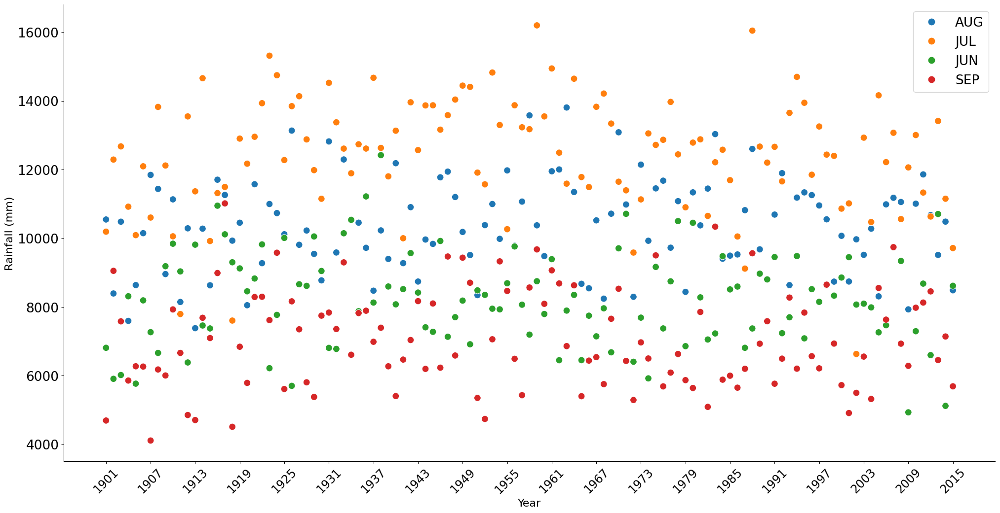

In [31]:
# Melt the DataFrame to long format
rainfall_melted = india_rainfall_data.melt(
    id_vars=["YEAR"], 
    value_vars=["JUN", "JUL", "AUG", "SEP"],  # include all month columns you want
    var_name="Month", 
    value_name="Rainfall"
)

# Group by Year and Month if you want summed values
individual_rainfall_sum = rainfall_melted.groupby(["YEAR", "Month"])["Rainfall"].sum().reset_index()

# Plot
g = sns.relplot(
    data=individual_rainfall_sum,
    x="YEAR",
    y="Rainfall",
    kind="scatter",
    hue="Month",
    height=10,
    aspect=2,
    s=100
)

# Set ticks every 3 years
plt.xticks(
    ticks=range(india_rainfall_data["YEAR"].min(), india_rainfall_data["YEAR"].max()+1, 6),
    rotation=45,
    fontsize=17
)

g._legend.remove()


plt.yticks(fontsize=19)
plt.legend(fontsize=19, title_fontsize=19)

# Increase axis labels font size
g.set_axis_labels("Year", "Rainfall (mm)", fontsize=16)
plt.show()

In [32]:
print(individual_rainfall_sum)

     YEAR Month  Rainfall
0    1901   AUG   10546.4
1    1901   JUL   10192.3
2    1901   JUN    6811.3
3    1901   SEP    4695.4
4    1902   AUG    8393.0
5    1902   JUL   12290.1
6    1902   JUN    5908.7
7    1902   SEP    9051.4
8    1903   AUG   10481.9
9    1903   JUL   12673.8
10   1903   JUN    6019.6
11   1903   SEP    7581.7
12   1904   AUG    7595.5
13   1904   JUL   10919.0
14   1904   JUN    8312.0
15   1904   SEP    5859.1
16   1905   AUG    8637.3
17   1905   JUL   10091.0
18   1905   JUN    5768.2
19   1905   SEP    6274.1
20   1906   AUG   10148.4
21   1906   JUL   12094.8
22   1906   JUN    8192.0
23   1906   SEP    6265.0
24   1907   AUG   11843.6
25   1907   JUL   10602.6
26   1907   JUN    7266.6
27   1907   SEP    4112.9
28   1908   AUG   11436.7
29   1908   JUL   13822.6
30   1908   JUN    6663.0
31   1908   SEP    6180.3
32   1909   AUG    8957.7
33   1909   JUL   12117.8
34   1909   JUN    9186.1
35   1909   SEP    6006.3
36   1910   AUG   11131.9
37   1910   